<a href="https://colab.research.google.com/github/yashrahmed/augv-project/blob/main/Introduction_to_stable_diffusion.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# The Railway Station Project

## Setup

In [1]:
# Ovveride from https://github.com/googlecolab/colabtools/issues/3409
# Fixes the following error
#NotImplementedError: A UTF-8 locale is required. Got ANSI_X3.4-1968

import locale

def locale_override(arg=None):
  return "UTF-8"

locale.getpreferredencoding = locale_override

In [2]:
!pip install torch accelerate diffusers['torch'] transformers datasets evaluate seqeval ftfy opencv-contrib-python controlnet_aux xformers gdown

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 227.6/227.6 kB 7.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 54.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 78.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 486.2/486.2 kB 49.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 81.4/81.4 kB 11.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.6/43.6 kB 4.1 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.1/53.1 kB 7.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 231.0/231.0 kB 28.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 109.1/109.1 MB 8.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 31.2 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB

## Common functions

In [3]:
import requests
import gdown
import PIL
from PIL import Image
from diffusers.utils import load_image

drive_file_prefix = "https://drive.google.com/uc?export=download&id="

def download_drive_image(url, name="image.png"):
    output = f'sample_data/{name}'
    gdown.download(url, output, quiet=False)
    return Image.open(output)

def download_image(image_url):
  response = requests.get(url=image_url, stream=True)
  return Image.open(response.raw)

## Upsampling

Demo link - https://huggingface.co/spaces/doevent/Face-Real-ESRGAN

## Load Reference painting

In [ ]:
painting_url = "https://www.rct.uk/sites/default/files/styles/rctr-scale-1300-500/public/collection-online/e/1/485873-1412247276.jpg?itok=FFQ3e3ge"

In [ ]:
painting_image = download_image(painting_url)

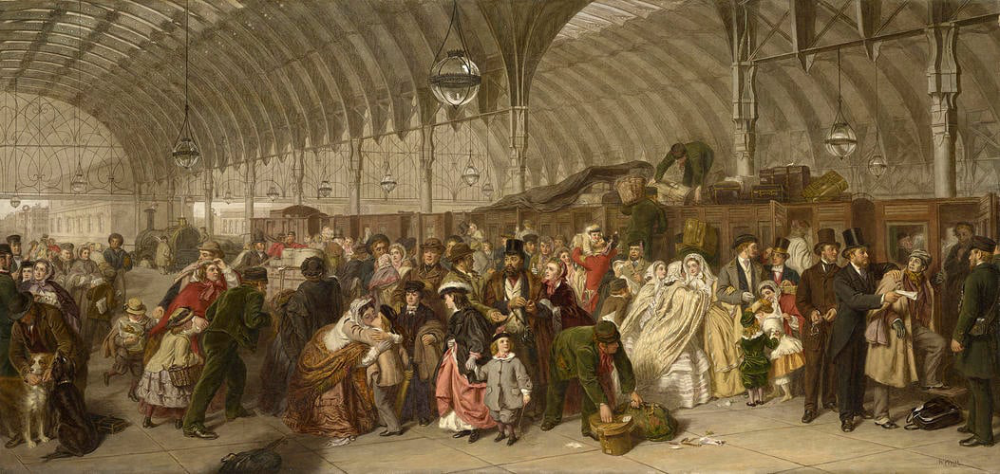

In [ ]:
painting_image

##Load target image

In [ ]:
hw_image_url = f"{drive_file_prefix}1zDYP5isad3HXIXr3OWGzuMj-XoifEUhX"

hw_image = download_drive_image(hw_image_url)

Downloading...
From: https://drive.google.com/uc?export=download&id=1zDYP5isad3HXIXr3OWGzuMj-XoifEUhX
To: /content/sample_data/image.png
100%|██████████| 421k/421k [00:00<00:00, 77.4MB/s]


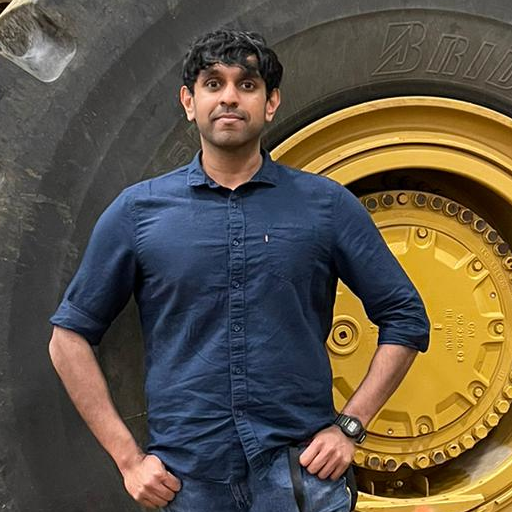

In [ ]:
hw_image

## Set Prompts

In [ ]:
prompt = "Realistic face, English Man in a full sleeved vitorian tuxedo in a luxury old first class train coach, Oil Painting, Victorian era, 19th century, Old London, by Claude Monet, highly detailed, trending artstation, daylight, colorful, High quality, very detailed, accurate anatomy, William Powell Frith"
prompt = "Male cyberpunk mercenary with scenic background. portrait illustration, pop art, art by ashley wood, alphonse mucha, laurie greasley and josan gonzales. cinematic. beautiful lighting."
prompt = "Very Beautiful ancient Anime Style of a tibetian monk with background monastery , highly detailed trending artstation Pixelate, daylight, Black and white Copy"

negative_prompts = "disfigured, ugly, bad, immature, longbody, lowres, bad anatomy, bad hands, missing fingers, extra digit, fewer digits, cropped, worst quality, low quality, NSFW"

inpaint_prompt = "A photo of a man standing in front a giant bulldozer"

## Method 1 - ControlNet on Canny and Posenet

### Generate Posenet image

In [ ]:
from controlnet_aux import OpenposeDetector

control_net_model_name_prefix = "lllyasviel/"

pose_detector_model_name = "ControlNet"

## setup openpose detector
pose_detector = OpenposeDetector.from_pretrained(f"{control_net_model_name_prefix}{pose_detector_model_name}")

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


In [ ]:
posenet_image = pose_detector(hw_image)

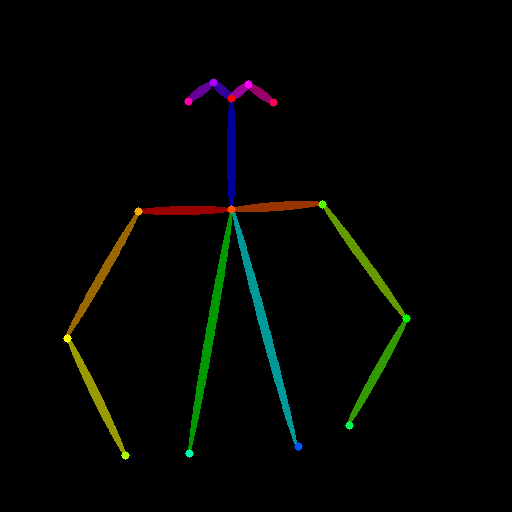

In [ ]:
posenet_image

In [ ]:
posenet_image.size

(512, 704)

### Generate Canny Image

In [ ]:
import cv2
import numpy as np

def canny_detector(input_image, low_thresh = 100, high_thresh = 200):
  image = np.array(input_image) if not type(input_image) == np.ndarray else input_image
  image = cv2.Canny(image, low_thresh, high_thresh)
  image = image[:, :, None] # convert an M * N image to a M * N * 1 image
  image = np.concatenate([image, image, image], axis=2)
  return Image.fromarray(image)

In [ ]:
canny_image = canny_detector(hw_image)

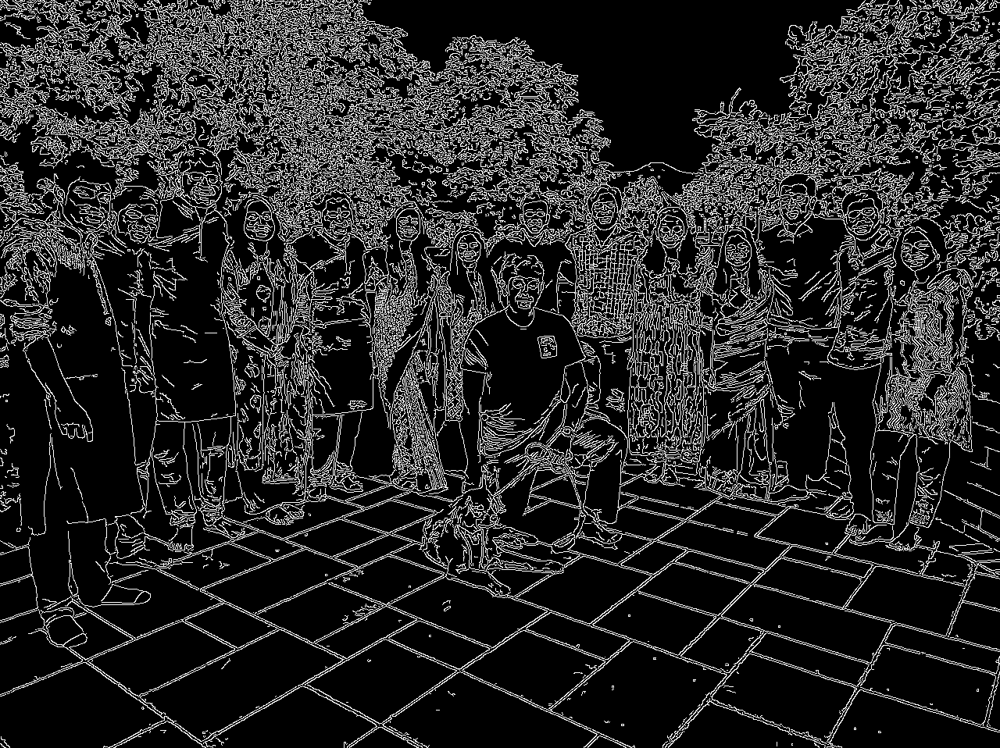

In [ ]:
canny_image

### Generate HED Image

In [ ]:
from controlnet_aux import HEDdetector

control_net_model_name_prefix = "lllyasviel/"

hed_detector_model_name = "ControlNet"

## setup HED detector
hed_detector = HEDdetector.from_pretrained(f"{control_net_model_name_prefix}{hed_detector_model_name}")

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


In [ ]:
hed_hw_image = hed_detector(hw_image)

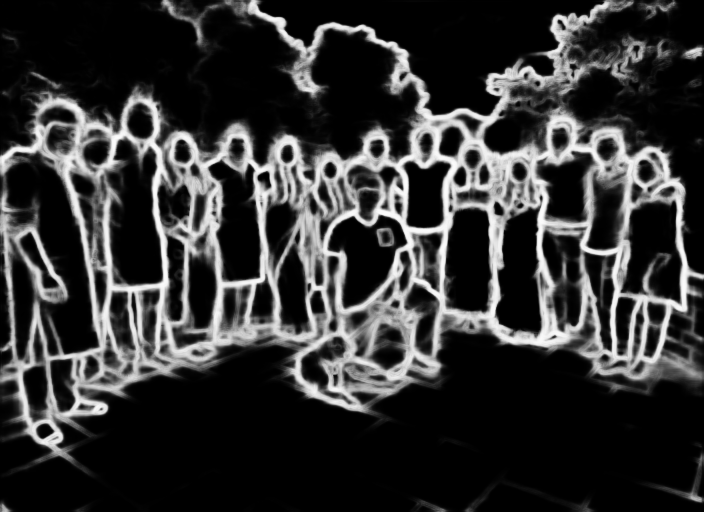

In [ ]:
hed_hw_image

### Generate HED scribble image

In [ ]:
from controlnet_aux import HEDdetector

control_net_model_name_prefix = "lllyasviel/"

scribble_detector_model_name = "Annotators"

## setup HED detector
scribble_detector = HEDdetector.from_pretrained(f"{control_net_model_name_prefix}{scribble_detector_model_name}")

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


In [ ]:
scribble_image = scribble_detector(hw_image, scribble=True)

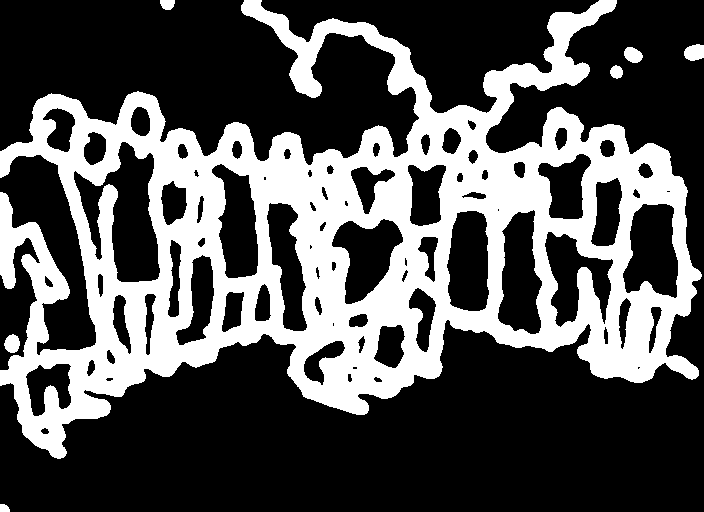

In [ ]:
scribble_image

### Load prepared scribble image

In [ ]:
scribble_image_url = f"{drive_file_prefix}1KhSb-nQRrrTBafERuu26eZJBDX4vTAe5"

scribble_image = download_drive_image(scribble_image_url)

Downloading...
From: https://drive.google.com/uc?export=download&id=1KhSb-nQRrrTBafERuu26eZJBDX4vTAe5
To: /content/sample_data/image.png
100%|██████████| 6.47k/6.47k [00:00<00:00, 22.2MB/s]


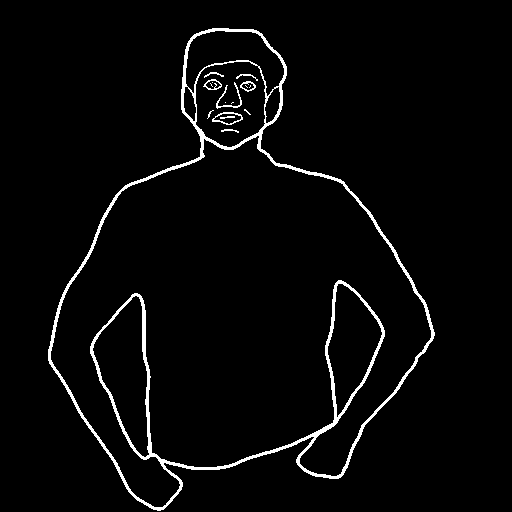

In [ ]:
scribble_image

In [ ]:
scribble_image = scribble_image.resize((512, 512))

### Setup Imports and Model Names

In [ ]:
from diffusers.pipelines import stable_diffusion_safe
from diffusers import ControlNetModel, StableDiffusionControlNetPipeline, StableDiffusionControlNetInpaintPipeline, UniPCMultistepScheduler, DDIMScheduler
import torch
import numpy as np

global_dtype = torch.float16
global_device = "cuda"

generator = torch.Generator(device="cpu").manual_seed(211)

control_net_model_name_prefix = "lllyasviel/"
stable_diffusion_model_name_prefix = "runwayml/"
# stable_diffusion_model_name_prefix = "stabilityai/"


pose_controlnet_model_name = "sd-controlnet-openpose"
canny_controlnet_model_name = "sd-controlnet-canny"
hed_controlnet_model_name = "sd-controlnet-hed"
inpaint_controlnet_model_name = "control_v11p_sd15_inpaint"
scribble_controlnet_model_name = "control_v11p_sd15_scribble"

stable_diffusion_model_name = "stable-diffusion-v1-5"
# stable_diffusion_model_name = "stable-diffusion-2-1"

### Run stable Diffusion (Canny + Posenet)

In [ ]:
## Setup controlnets, stable diffusion pipelines and scheduler
cannypose_controlnet_models = [
    ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{pose_controlnet_model_name}", torch_dtype=global_dtype),
    ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{canny_controlnet_model_name}", torch_dtype=global_dtype)
]

cannypose_pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
    controlnet=cannypose_controlnet_models,
    torch_dtype = global_dtype)

cannypose_pipeline.scheduler = UniPCMultistepScheduler.from_config(cannypose_pipeline.scheduler.config)
cannypose_pipeline.enable_xformers_memory_efficient_attention()
cannypose_pipeline.to(global_device)

/usr/local/lib/python3.10/dist-packages/controlnet_aux/mediapipe_face/mediapipe_face_common.py:7: UserWarning: The module 'mediapipe' is not installed. The package will have limited functionality. Please install it using the command: pip install 'mediapipe'
  warnings.warn(


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.17.0",
  "controlnet": [
    "controlnet",
    "MultiControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "UniPCMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
posenet_image_rsz = posenet_image.resize(canny_image.size, resample=PIL.Image.NEAREST)

In [ ]:
images = [posenet_image_rsz, canny_image]
output_image = cannypose_pipeline(prompt,
         images,
         num_inference_steps=30,
         generator=generator,
         negative_prompt=negative_prompts,
         controlnet_conditioning_scale=[0.5, 0.8]).images[0]

  0%|          | 0/30 [00:00<?, ?it/s]

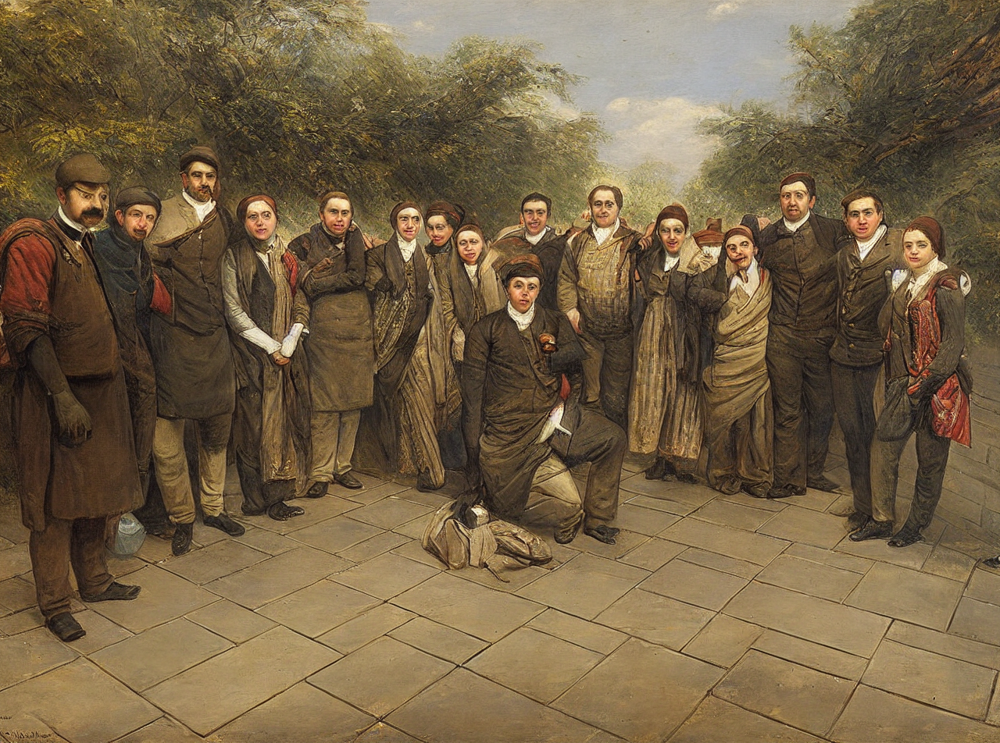

In [ ]:
output_image

### Run stable diffusion (Canny)

In [ ]:
## Setup controlnets, stable diffusion pipelines and scheduler
canny_controlnet_model = ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{canny_controlnet_model_name}", torch_dtype=global_dtype)

canny_pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
    controlnet=canny_controlnet_model,
    torch_dtype = global_dtype)

# canny_pipeline.scheduler = UniPCMultistepScheduler.from_config(canny_pipeline.scheduler.config)
canny_pipeline.scheduler = DDIMScheduler.from_config(canny_pipeline.scheduler.config)
canny_pipeline.enable_xformers_memory_efficient_attention()
canny_pipeline.to(global_device)

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.17.1",
  "controlnet": [
    "diffusers",
    "ControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "DDIMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
images = [canny_image]
output_images = canny_pipeline(prompt,
         images,
         num_inference_steps=35,
         generator=generator,
         negative_prompt=negative_prompts,
         num_images_per_prompt=4,
         controlnet_conditioning_scale=0.8).images

  0%|          | 0/35 [00:00<?, ?it/s]

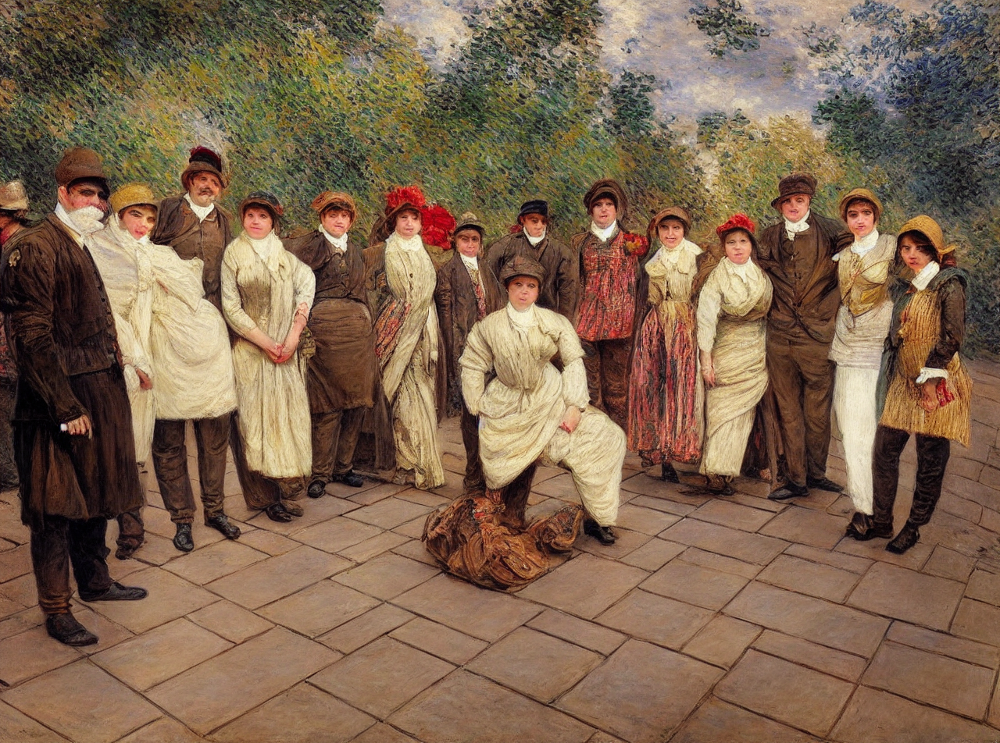

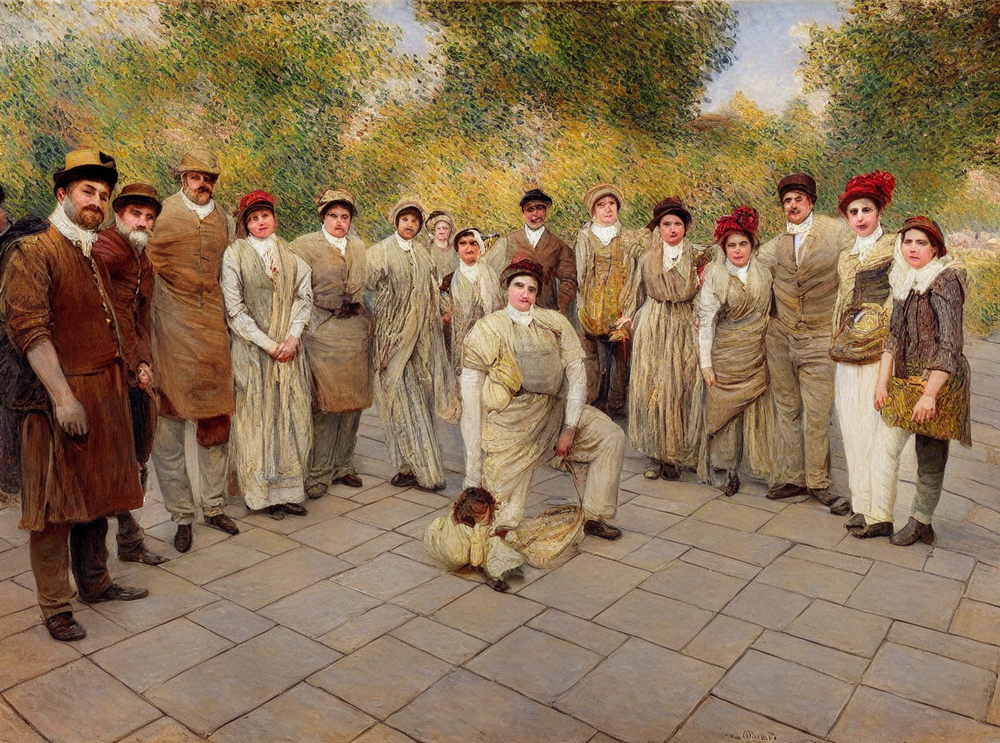

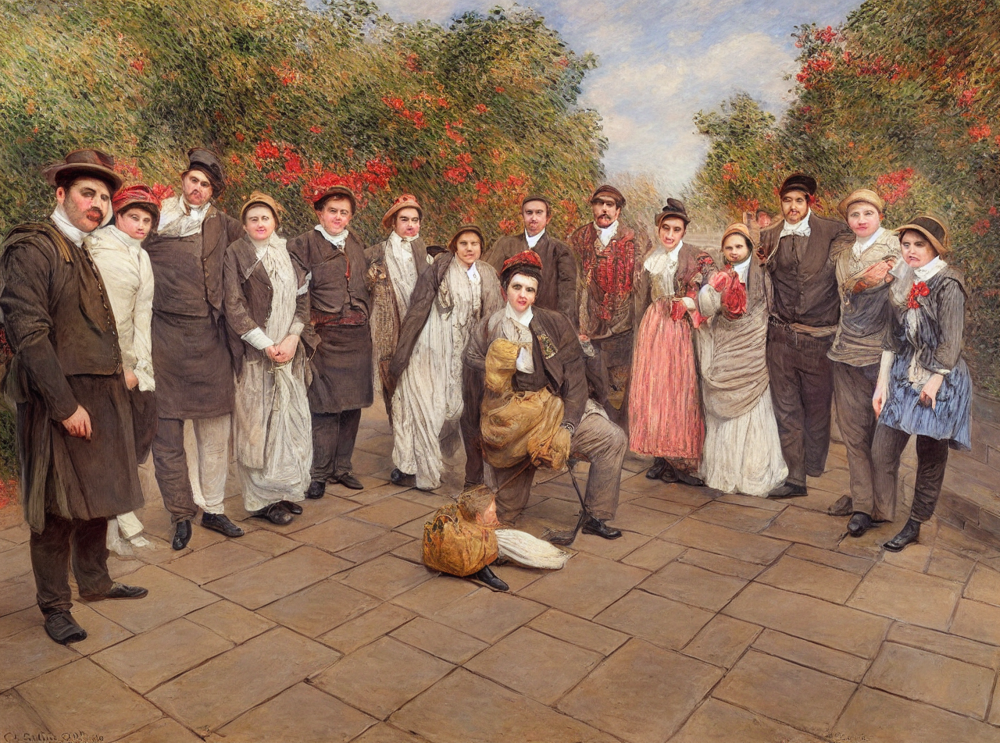

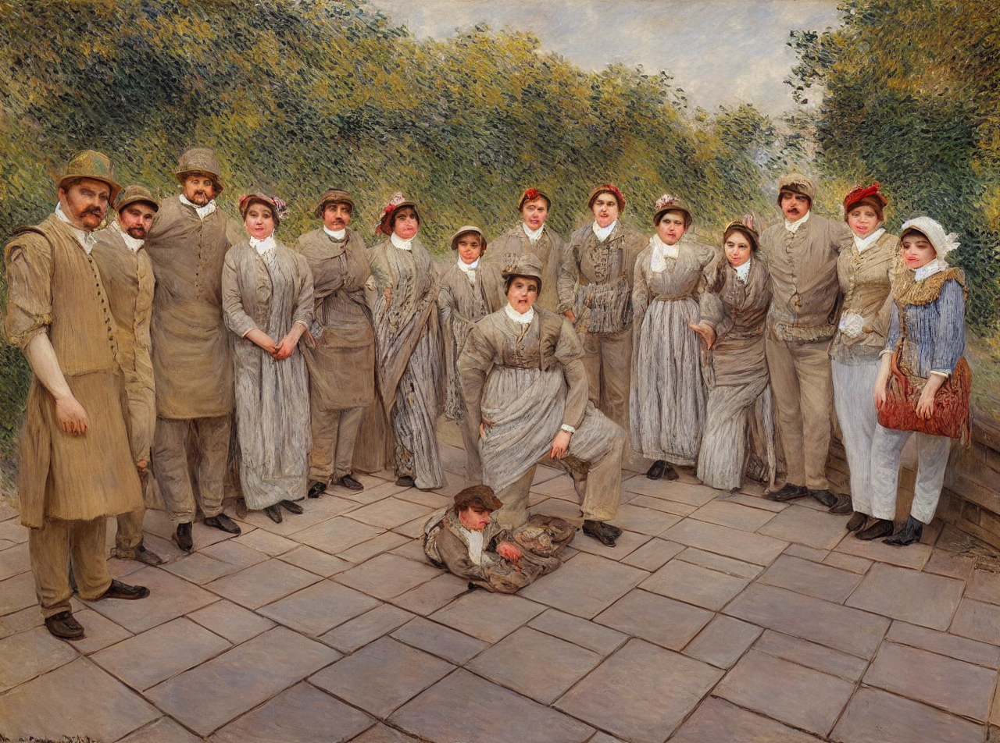

In [ ]:
for picture in output_images:
  display(picture)

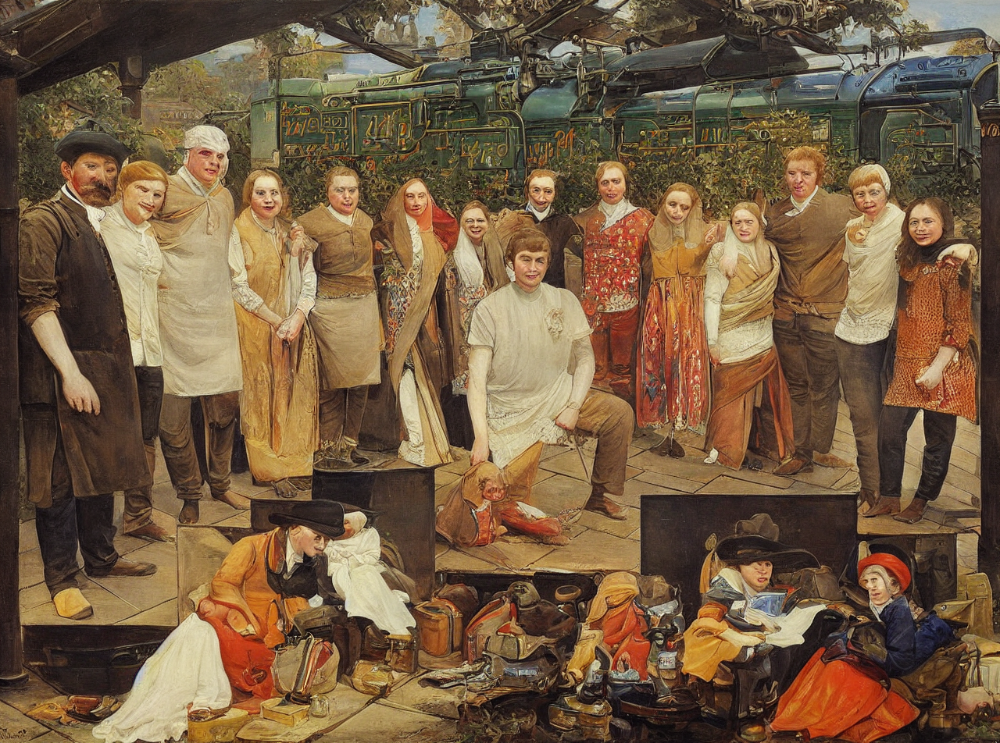

In [ ]:
output_images[0]

### Run stable diffusion (HED)

In [ ]:
hed_controlnet_models = [
    ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{hed_controlnet_model_name}", torch_dtype=global_dtype)
]

hed_pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
    controlnet=hed_controlnet_models,
    torch_dtype = global_dtype)

# hed_pipeline.scheduler = UniPCMultistepScheduler.from_config(hed_pipeline.scheduler.config)
hed_pipeline.scheduler = DDIMScheduler.from_config(hed_pipeline.scheduler.config)
hed_pipeline.enable_xformers_memory_efficient_attention()
hed_pipeline.to(global_device)

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.17.1",
  "controlnet": [
    "controlnet",
    "MultiControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "DDIMScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
images = [hed_hw_image]

results = hed_pipeline(prompt,
                     images,
                     num_inference_steps=30,
                     generator=generator,
                     negative_prompt=negative_prompts,
                     num_images_per_prompt = 4,
                     controlnet_conditioning_scale = [0.8]).images

  0%|          | 0/30 [00:00<?, ?it/s]

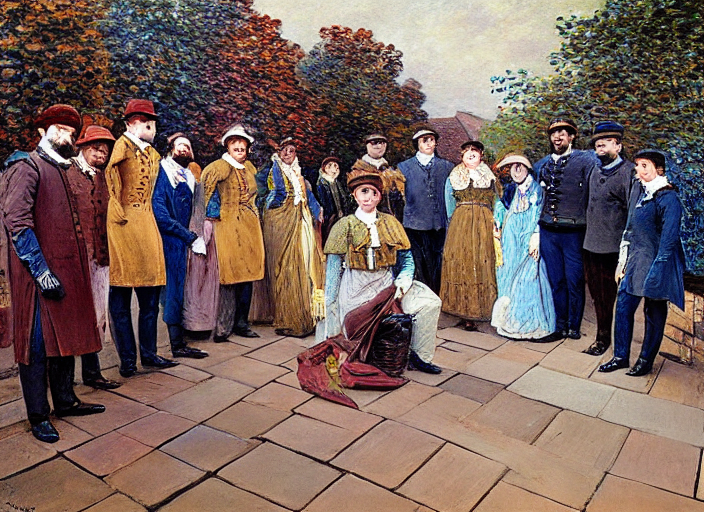

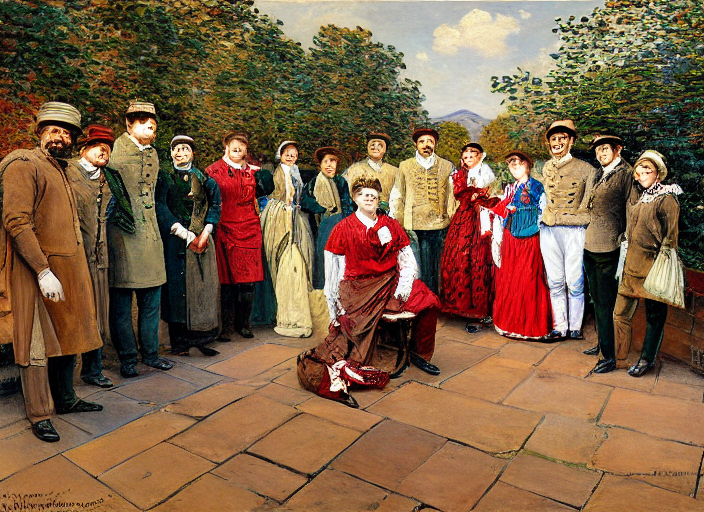

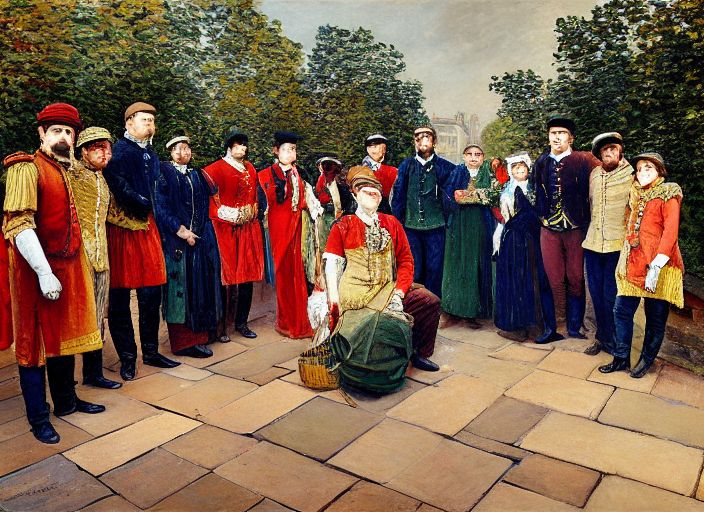

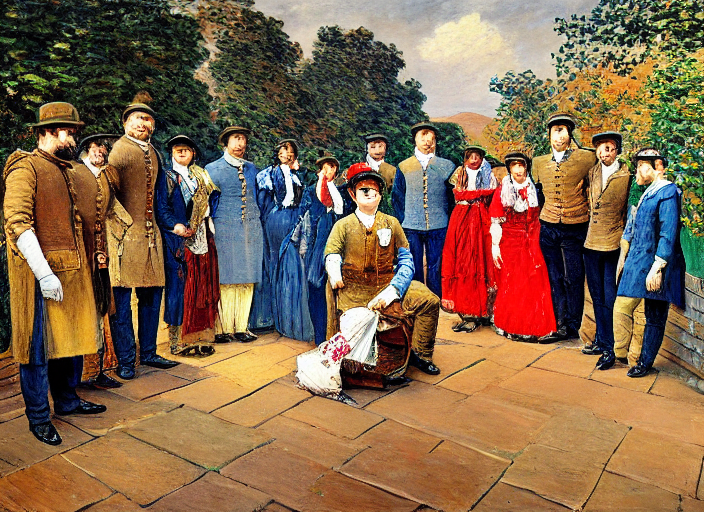

In [ ]:
for result in results:
  display(result)

### Run Stable Diffusion (HED + Posenet)

In [ ]:
hed_pose_controlnet_models = [
    ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{pose_controlnet_model_name}", torch_dtype=global_dtype),
    ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{hed_controlnet_model_name}", torch_dtype=global_dtype)
]

hed_pose_pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
    controlnet=hed_pose_controlnet_models,
    torch_dtype = global_dtype)

# hed_pipeline.scheduler = UniPCMultistepScheduler.from_config(hed_pipeline.scheduler.config)
hed_pose_pipeline.scheduler = DDIMScheduler.from_config(hed_pose_pipeline.scheduler.config)
hed_pose_pipeline.enable_xformers_memory_efficient_attention()
hed_pose_pipeline.to(global_device)

Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

╭─────────────────────────────── Traceback (most recent call last) ────────────────────────────────╮
│ in <cell line: 6>:6                                                                              │
│                                                                                                  │
│ /usr/local/lib/python3.10/dist-packages/diffusers/pipelines/pipeline_utils.py:908 in             │
│ from_pretrained                                                                                  │
│                                                                                                  │
│    905 │   │   # 1. Download the checkpoints and configs                                         │
│    906 │   │   # use snapshot download here to get it working from from_pretrained               │
│    907 │   │   if not os.path.isdir(pretrained_model_name_or_path):                              │
│ ❱  908 │   │   │   cached_folder = cls.download(                                                 │
│    909 │   │   │   │   pretrained_model_name_or_path,                                            │
│    910 │   │   │   │   cache_dir=cache_dir,                                                      │
│    911 │   │   │   │   resume_download=resume_download,                                          │
│                                                                                                  │
│ /usr/local/lib/python3.10/dist-packages/diffusers/pipelines/pipeline_utils.py:1349 in download   │
│                                                                                                  │
│   1346 │   │   │   user_agent["custom_pipeline"] = custom_pipeline                               │
│   1347 │   │                                                                                     │
│   1348 │   │   # download all allow_patterns - ignore_patterns                                   │
│ ❱ 1349 │   │   cached_folder = snapshot_download(                                                │
│   1350 │   │   │   pretrained_model_name,                                                        │
│   1351 │   │   │   cache_dir=cache_dir,                                                          │
│   1352 │   │   │   resume_download=resume_download,                                              │
│                                                                                                  │
│ /usr/local/lib/python3.10/dist-packages/huggingface_hub/utils/_validators.py:118 in _inner_fn    │
│                                                                                                  │
│   115 │   │   if check_use_auth_token:                                                           │
│   116 │   │   │   kwargs = smoothly_deprecate_use_auth_token(fn_name=fn.__name__, has_token=ha   │
│   117 │   │                                                                                      │
│ ❱ 118 │   │   return fn(*args, **kwargs)                                                         │
│   119 │                                                                                          │
│   120 │   return _inner_fn  # type: ignore                                                       │
│   121                                                                                            │
│                                                                                                  │
│ /usr/local/lib/python3.10/dist-packages/huggingface_hub/_snapshot_download.py:235 in             │
│ snapshot_download                                                                                │
│                                                                                                  │
│   232 │   │   for file in filtered_repo_files:                                                   │
│   233 │   │   │   _inner_hf_hub_download(file)                                                   │
│   234 │   else:                                            

In [ ]:
images = [posenet_image, hed_hw_image]
# images = [posenet_image]

results = hed_pose_pipeline(prompt,
                     images,
                     num_inference_steps=50,
                     generator=generator,
                     negative_prompt=negative_prompts,
                     num_images_per_prompt = 4,
                     controlnet_conditioning_scale = [1, 0.5]).images

  0%|          | 0/50 [00:00<?, ?it/s]

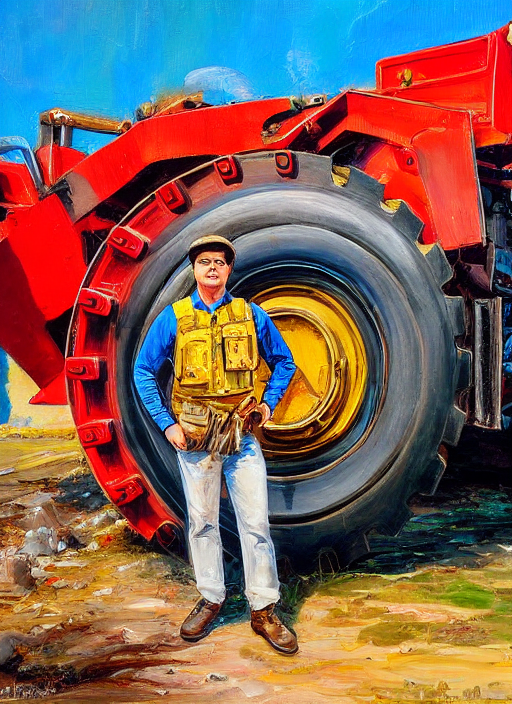

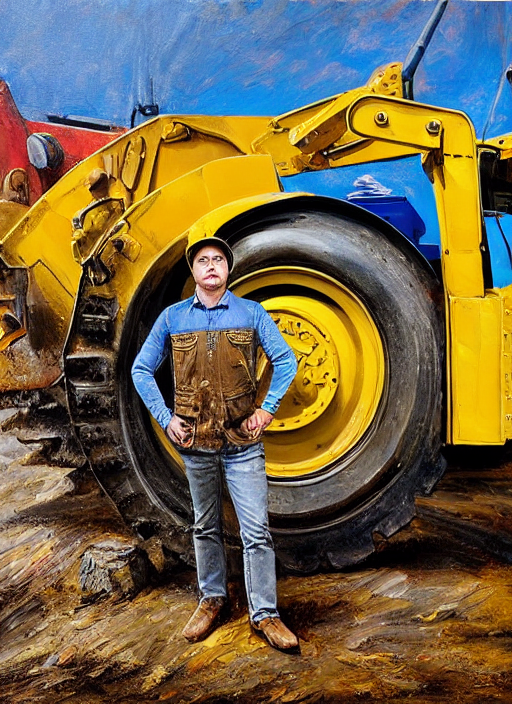

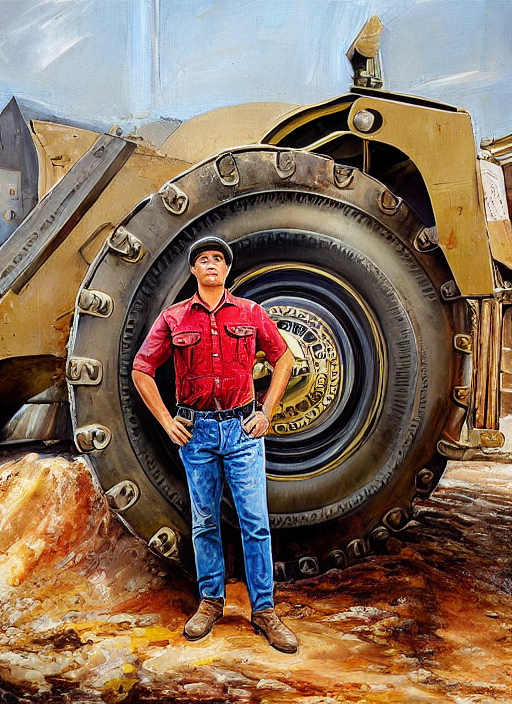

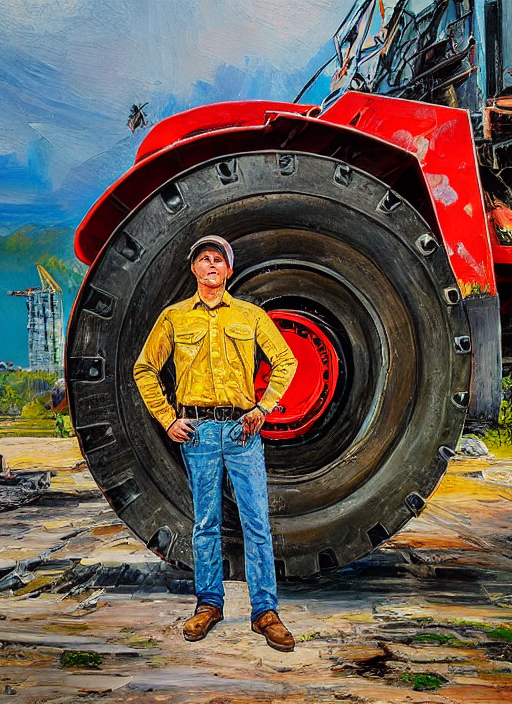

In [ ]:
for picture in results:
  display(picture)

### Run stable diffusion (Scribble-HED)

In [ ]:
scribble_controlnet = [ControlNetModel.from_pretrained(
    f"{control_net_model_name_prefix}{scribble_controlnet_model_name}",
    torch_dtype=global_dtype)]

scribble_pipeline = StableDiffusionControlNetPipeline.from_pretrained(
    f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
    controlnet=scribble_controlnet,
    torch_dtype=global_dtype)

scribble_pipeline.scheduler = UniPCMultistepScheduler.from_config(scribble_pipeline.scheduler.config)
scribble_pipeline.enable_xformers_memory_efficient_attention()
scribble_pipeline.to(global_device)


Fetching 15 files:   0%|          | 0/15 [00:00<?, ?it/s]

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


StableDiffusionControlNetPipeline {
  "_class_name": "StableDiffusionControlNetPipeline",
  "_diffusers_version": "0.17.1",
  "controlnet": [
    "controlnet",
    "MultiControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "UniPCMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
images = [scribble_image]

scribble_results = scribble_pipeline(prompt,
                     images,
                     num_inference_steps=50,
                     generator=generator,
                     negative_prompt=negative_prompts,
                     num_images_per_prompt = 4,
                     controlnet_conditioning_scale = [0.75]).images

  0%|          | 0/50 [00:00<?, ?it/s]

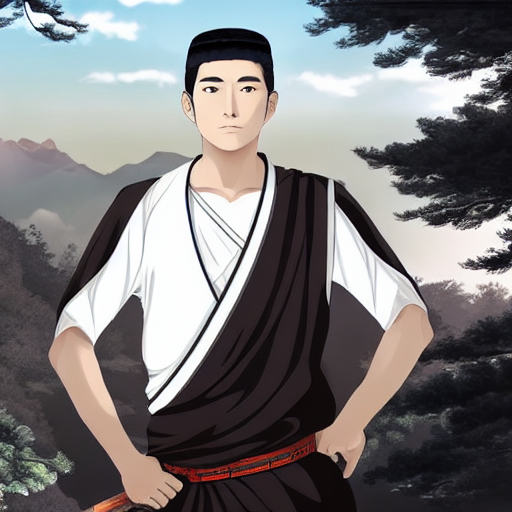

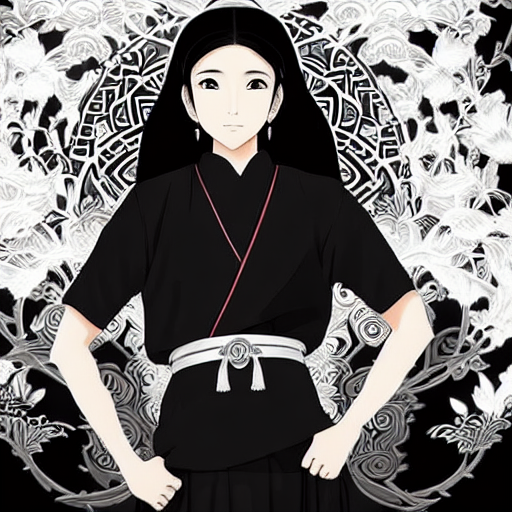

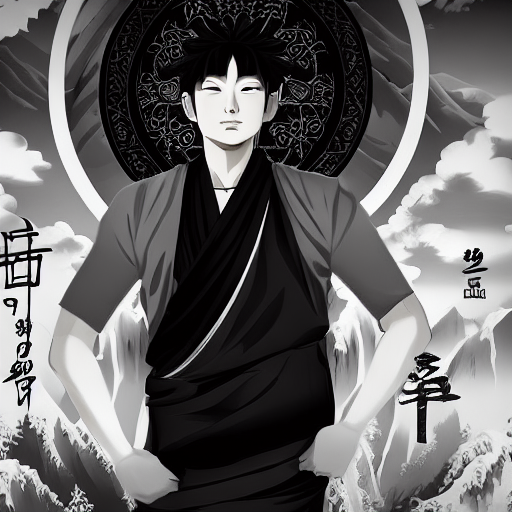

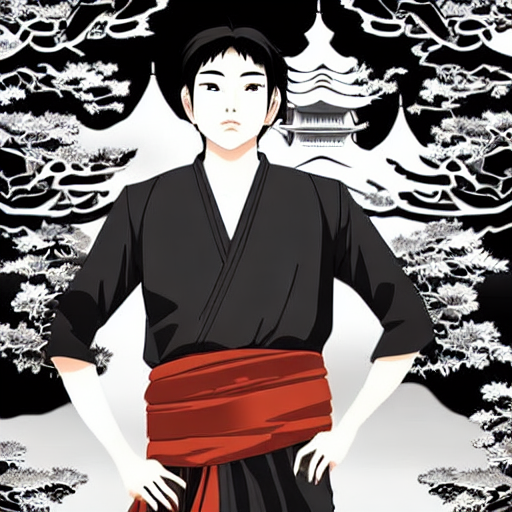

In [ ]:
for result in scribble_results:
  display(result)

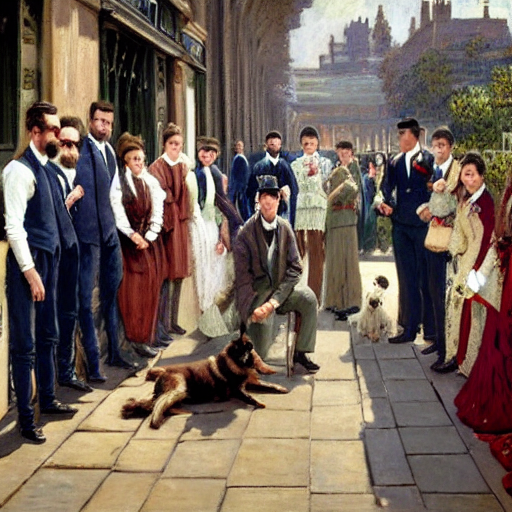

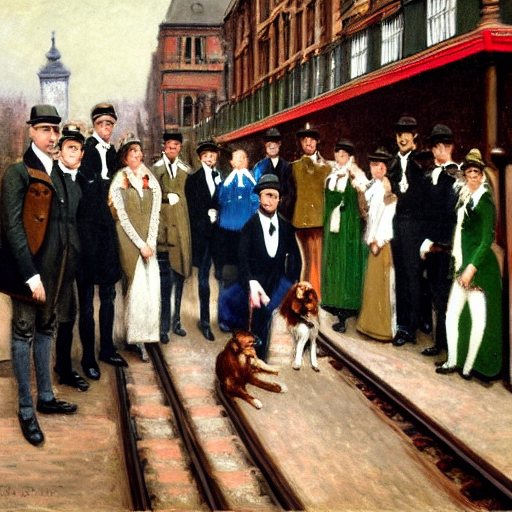

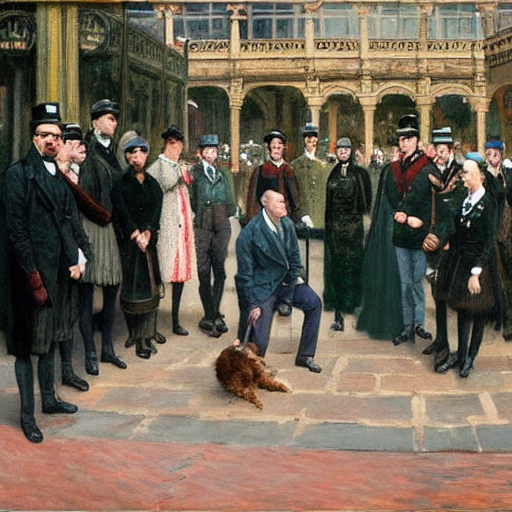

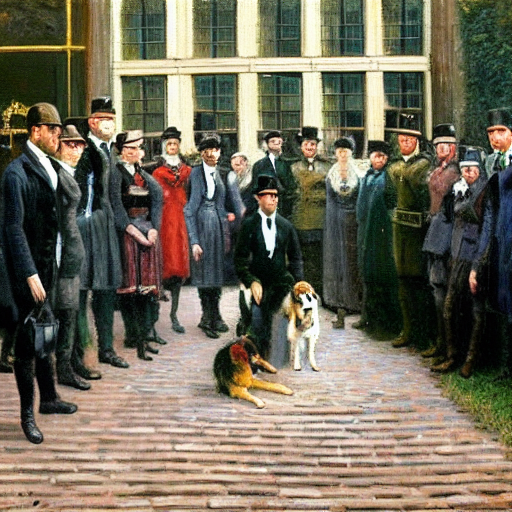

In [ ]:
for result in scribble_results:
  display(result)

### [Test] Inpainting

In [ ]:
init_image_url = f"{drive_file_prefix}1vMsKLnHyS7bGBQl0_-Mu7REk912f3X7T"
init_image = download_drive_image(init_image_url)

mask_image_url = f"{drive_file_prefix}1r9cAfIeRGY7s87xW5YGU3AYLbBG10y4A"
mask_image = download_drive_image(mask_image_url, name='mask.png')

Downloading...
From: https://drive.google.com/uc?export=download&id=1vMsKLnHyS7bGBQl0_-Mu7REk912f3X7T
To: /content/sample_data/image.png
100%|██████████| 764k/764k [00:00<00:00, 97.6MB/s]
Downloading...
From: https://drive.google.com/uc?export=download&id=1r9cAfIeRGY7s87xW5YGU3AYLbBG10y4A
To: /content/sample_data/mask.png
100%|██████████| 11.7k/11.7k [00:00<00:00, 35.0MB/s]


In [ ]:
def craft_inpaint_condition(src_image, masked_image):
  img = np.array(src_image.convert("RGB")).astype(np.float32) / 255.0
  mask_img = np.array(masked_image.convert("L")).astype(np.float32) / 255.0
  assert img.shape[0:1] == mask_img.shape[0:1]
  img[mask_img > 0.5] = -1.0  #force to -1 for masked locations
  return torch.from_numpy(np.expand_dims(img, 0).transpose(0, 3, 1, 2))

In [ ]:
control_image = craft_inpaint_condition(init_image, mask_image)

In [ ]:
inpaint_control_net = ControlNetModel.from_pretrained(f"{control_net_model_name_prefix}{inpaint_controlnet_model_name}", torch_dtype=global_dtype)
inpaint_pipe = StableDiffusionControlNetInpaintPipeline.from_pretrained(f"{stable_diffusion_model_name_prefix}{stable_diffusion_model_name}",
                                                         controlnet=inpaint_control_net,
                                                         torch_dtype=global_dtype)

# inpaint_pipe.scheduler = DDIMScheduler.from_config(inpaint_pipe.scheduler.config)
inpaint_pipe.scheduler = UniPCMultistepScheduler.from_config(inpaint_pipe.scheduler.config)
inpaint_pipe.to(global_device)

`text_config_dict` is provided which will be used to initialize `CLIPTextConfig`. The value `text_config["id2label"]` will be overriden.


StableDiffusionControlNetInpaintPipeline {
  "_class_name": "StableDiffusionControlNetInpaintPipeline",
  "_diffusers_version": "0.17.1",
  "controlnet": [
    "diffusers",
    "ControlNetModel"
  ],
  "feature_extractor": [
    "transformers",
    "CLIPImageProcessor"
  ],
  "requires_safety_checker": true,
  "safety_checker": [
    "stable_diffusion",
    "StableDiffusionSafetyChecker"
  ],
  "scheduler": [
    "diffusers",
    "UniPCMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

In [ ]:
control_image.shape

torch.Size([1, 3, 704, 512])

In [ ]:
inpaint_results = inpaint_pipe(
    inpaint_prompt,
    num_inference_steps=50,
    generator=generator,
    eta = 1.0,
    image = init_image,
    mask_image = mask_image,
    control_image = control_image,
    num_images_per_prompt = 4).images

  0%|          | 0/50 [00:00<?, ?it/s]

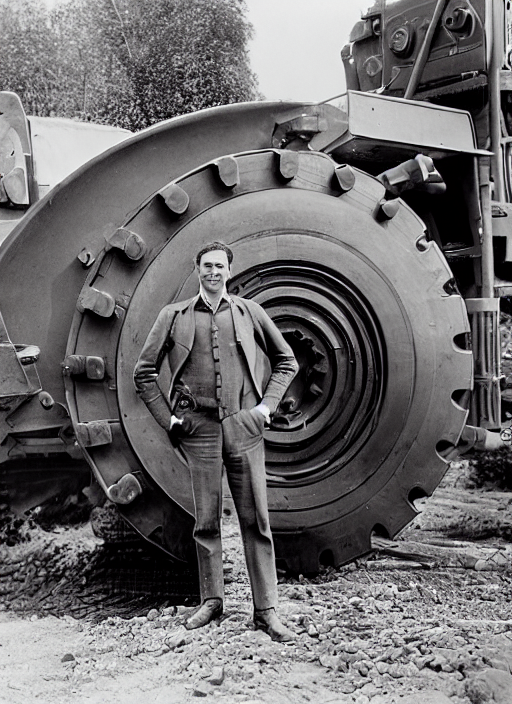

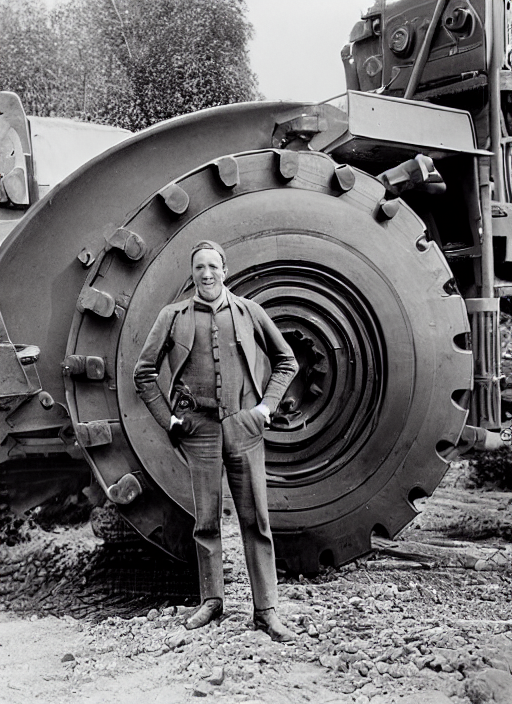

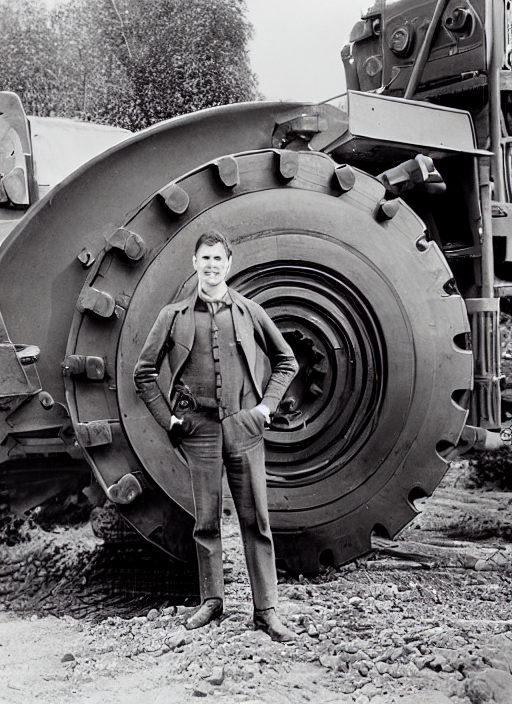

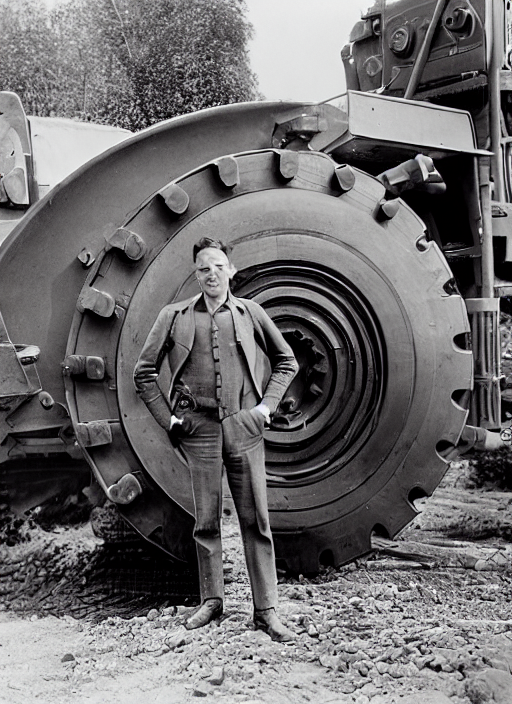

In [ ]:
for result in inpaint_results:
  display(result)

## Tests with Lineart ControlNet

In [4]:
from controlnet_aux import LineartAnimeDetector

processor = LineartAnimeDetector.from_pretrained("lllyasviel/Annotators")

In [5]:
image = load_image("https://huggingface.co/lllyasviel/control_v11p_sd15s2_lineart_anime/resolve/main/images/input.png")

In [7]:
image.size

(1600, 2400)

In [14]:
scaled_image = image.resize((512, 768))

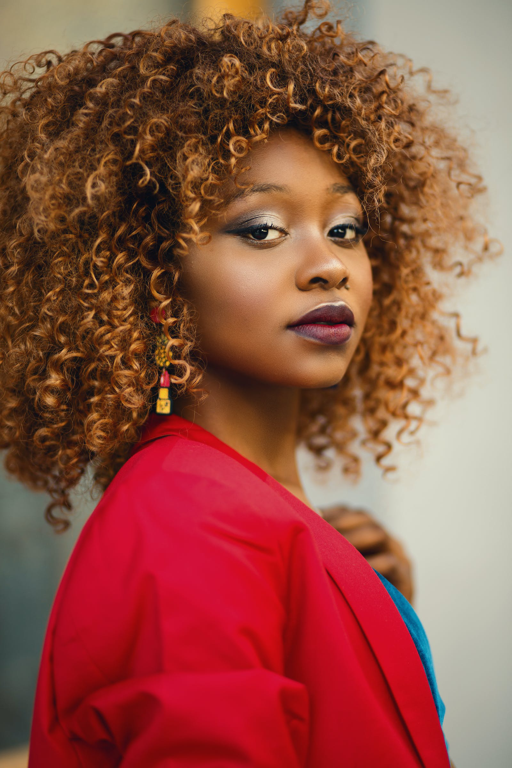

In [15]:
scaled_image

In [18]:
lineart_image = processor(scaled_image)

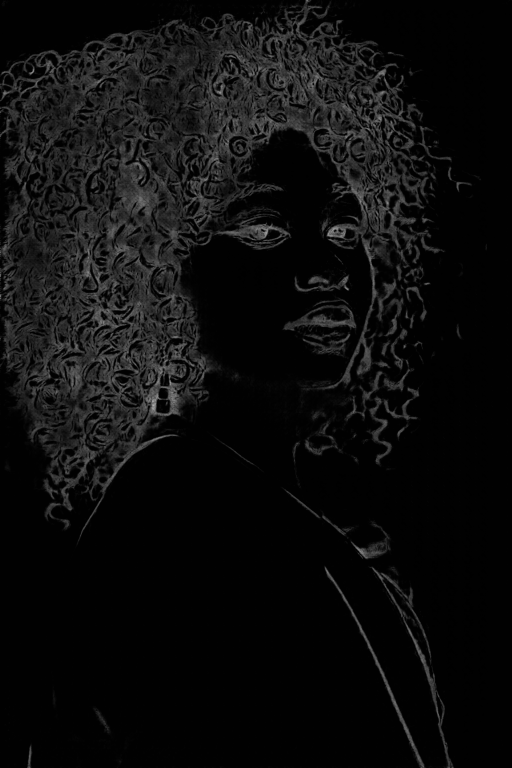

In [19]:
lineart_image